In [1]:
import jax
import jax.numpy as jnp
from jax.experimental import optimizers
import os
import h5py
import numpy as onp
import time
import cardiax
import deepx
from deepx import optimise
import helx
from helx.types import Optimiser
import json
import wandb
import pickle
import IPython
from IPython.display import display
from IPython.display import display_javascript
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import matplotlib.animation as animation
import helx
from matplotlib import rc
from functools import partial
from matplotlib.animation import FuncAnimation
from matplotlib.ticker import FuncFormatter
import seaborn as sns

import matplotlib.patches as mpatches

rc('animation', html='jshtml')
rc('text', usetex=False)


plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']

# rc['animation.embed_limit'] = 2**128
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [2]:
def grad_loss(y_hat, y):

    # first derivative
    grad_y_hat_x = cardiax.solve.gradient(y_hat, -1)
    grad_y_hat_y = cardiax.solve.gradient(y_hat, -2)
    grad_y_x = cardiax.solve.gradient(y, -1)
    grad_y_y = cardiax.solve.gradient(y, -2)
    grad_loss_x = (grad_y_hat_x - grad_y_x) ** 2  # rmse
    grad_loss_y = (grad_y_hat_y - grad_y_y) ** 2  # rmse
    grad_loss = grad_loss_x + grad_loss_y
    return grad_loss


def compare(y_hat, y, diffusivity=None, times=None, **kwargs):  
    rows = 3
    cols = 3 + int(diffusivity is not None)
    fig, ax = plt.subplots(
        rows,
        cols,
        figsize=(kwargs.pop("figsize", None) or (25, 15)),
    )
    ax = onp.array(ax)
    vmin = kwargs.pop("vmin", 0)
    vmax = kwargs.pop("vmax", 1)
    cmap = kwargs.pop("cmap", "Blues")
    title = kwargs.pop("title", "")
    
    
    l1 = jnp.abs(y_hat - y)# / (y.max() - y.min())
    states = (y_hat, y, l1)
    
    pad = 5 # in points
    col_names = cardiax.solve.State._fields + ("σ", )
    for _ax, col in zip(ax[0], col_names):
        _ax.annotate(col, xy=(0.5, 1), xytext=(0, pad),
                    xycoords='axes fraction', textcoords='offset points',
                    size='large', ha='center', va='baseline')
    
    row_names = ("Prediction", "Target", "Mean squared error",)
    for _ax, row in zip(ax[:, 0], row_names):
        _ax.annotate(row, xy=(0, 0.5), xytext=(-_ax.yaxis.labelpad - pad, 0),
                    xycoords=_ax.yaxis.label, textcoords='offset points',
                    size='large', ha='right', va='center', rotation=90)
    
    for r in range(rows):
        state = cardiax.solve.State(*(states[r].squeeze()))
        for c in range(cols - int(diffusivity is not None)):
            im = ax[r, c].imshow(state[c], vmin=vmin, vmax=vmax, cmap=cmap, **kwargs)
            ax[r, c].set_xlabel("x [cm]")
            ax[r, c].set_ylabel("y [cm]")
            ax[r, c].xaxis.set_major_formatter(
                FuncFormatter(lambda d, _: "{:.1f}".format(d / 100 * 1200 / 256))
            )
            ax[r, c].yaxis.set_major_formatter(
                FuncFormatter(lambda d, _: "{:.1f}".format(d / 100 * 1200 / 256))
            )
            cb = plt.colorbar(im, ax=ax[r, c])
#             if r >= 2:
#                 cb.ax.set_yticklabels(["{0:.3f}%".format(i / 100) for i in cb.get_ticks()]) # set ticks of your format
                

        if diffusivity is not None:
            im = ax[r, -1].imshow(diffusivity, cmap="gray")
            ax[r, -1].set_xlabel("x [cm]")
            ax[r, -1].set_ylabel("y [cm]")
            ax[r, -1].xaxis.set_major_formatter(
                FuncFormatter(lambda d, _: "{:.1f}".format(d / 100 * 1200 / 256))
            )
            ax[r, -1].yaxis.set_major_formatter(
                FuncFormatter(lambda d, _: "{:.1f}".format(d / 100 * 1200 / 256))
            )            
            clb = plt.colorbar(im, ax=ax[r, -1])
            clb.ax.set_title("[cm^2/ms]")
    
    fig.suptitle(title)
    fig.tight_layout()
    return fig, ax


def plot_loss(l1, j, ax=None, **kwargs):
    cmap = kwargs.pop("cmap", matplotlib.cm.get_cmap("Blues"))
    colors = reversed([cmap(i) for i in jnp.linspace(0.3, 1, 6)])  #cmap(0.70), cmap(0.5), cmap(0.30)
    
    if ax is None:
        figsize = kwargs.pop("figsize", None) or (10, 5)
        fig, ax = plt.subplots(1, 1, figsize=figsize)
    else:
        fig = None
    
    losses = (*l1.T, *j.T)
    ax.stackplot(jnp.arange(0, len(losses[0])), *losses, colors=colors, labels=("recon-v", "recon-w", "recon-u", "grad-v", "grad-w", "grad-u"), edgecolor="white")
    ax.set_xlim(0, len(losses[0]) - 1)
    ax.set_ylim(0, 1)
    ax.set_xlabel("Time [ms]")
    ax.set_ylabel("Mean squared error")
    ax.xaxis.set_major_formatter(
            FuncFormatter(lambda d, _: "{:.1f}ms".format(d * 5))
        ) 
    ax.legend(loc="upper left")
    return fig, ax


def load_diffusivity(filename, normalise=True):
    with h5py.File(filename, "r") as sequence:
        diffusivity = onp.array(sequence["diffusivity"])
        if normalise:
            diffusivity = diffusivity * 500
        return diffusivity

    
def take(filename, t, length, normalise=False):
    with h5py.File(filename, "r") as sequence:
        states = onp.array(
            sequence["states"][
                t : t + (2 + length)
            ]
        )
        diffusivity = onp.array(sequence["diffusivity"])
        if normalise:
            diffusivity = diffusivity * 500
        diffusivity = onp.tile(diffusivity[None, None], (2, 1, 1, 1))
        xs = onp.concatenate([states[:2], diffusivity], axis=-3)
        ys = states[2:]
        xs = xs[None, None]
        ys = ys[None, None]
        print(xs.shape, ys.shape)
        return xs, ys
    
    
def animate_state(a, d, filename=None):
    states_a = [cardiax.solve.State(*x) for x in a.squeeze()]
    anim = cardiax.plot.animate_state(states_a, d, cmap="Blues", vmin=0, vmax=1)
    display(anim)
    if filename is not None:
        anim.save("data/{}".format(filename))
    return anim


def load_model(url):
    train_state = deepx.optimise.TrainState.restore(url)
    hparams = train_state.hparams
    model = deepx.resnet.ResNet(hparams.hidden_channels, 1, hparams.depth)
    opt = optimizers.adam(0.001)
    params = opt.params_fn(train_state.opt_state)
    return model, hparams, params


@partial(
    jax.pmap,
    in_axes=(None, None, 0, 0),
    static_broadcasted_argnums=(0, 1),
    axis_name="device",
)
def infer_with_clip(model, n_refeed, params, xs, clip):
    def body_fun(inputs, i):
        x = inputs
        y_hat = model.apply(params, x)
        y_hat = jnp.clip(y_hat, clip)
        x = deepx.optimise.refeed(x, y_hat)  #  add the new pred to the inputs
        return x, y_hat

    _, ys_hat = jax.lax.scan(body_fun, xs, xs=jnp.arange(n_refeed))
    ys_hat = jnp.swapaxes(jnp.squeeze(ys_hat), 0, 1)
    return ys_hat


def evaluate_with_clip(url, xs, n_refeed, ys=None, clip=0.1):
    model, hparams, params = load_model(url)
    start = time.time()
    ys_hat = infer_with_clip(model, n_refeed, params, xs, clip)
    print("Solved forward propagation to {}ms in: {}s".format(n_refeed / 0.01, time.time() - start))
    ys_hat = jnp.swapaxes(ys_hat, -3, -4)[None]
    loss = None
    if ys is not None:
        assert ys_hat.shape == ys.shape, "ys_hat and ys are of different shapes {} and {}".format(ys_hat.shape, ys.shape)
        loss = jnp.mean((ys_hat - ys) ** 2, axis=(0, 1, 3, 4, 5))
    return ys_hat, loss


def evaluate(url, xs, n_refeed, ys=None):
    model, hparams, params = load_model(url)
    start = time.time()
    ys_hat = deepx.optimise.infer(model, n_refeed, params, xs)
    print("Solved forward propagation to {}ms in: {}s".format(n_refeed / 0.01, time.time() - start))
    if ys_hat.shape[0] == 1:
        ys_hat = jnp.swapaxes(ys_hat, -3, -4)[None]
    loss = None
    if ys is not None:
        assert ys_hat.shape == ys.shape, "ys_hat and ys are of different shapes {} and {}".format(ys_hat.shape, ys.shape)
        loss = jnp.mean((ys_hat - ys) ** 2, axis=(0, 1, 4, 5))
    return ys_hat, loss

## Linear wave propagation

In [5]:
FILENAME = "data/linear_homogeneous.hdf5"
N_REFEED = 100
URL = "p3aetobr/10351"  # TOP

In [6]:
xs_linear, ys_linear = take(FILENAME, 0, N_REFEED, True)
ys_hat_linear, loss_linear = evaluate(URL, xs_linear, N_REFEED, ys_linear)

(1, 1, 2, 4, 256, 256) (1, 1, 100, 3, 256, 256)
Solved forward propagation to 10000.0ms in: 7.521520614624023s


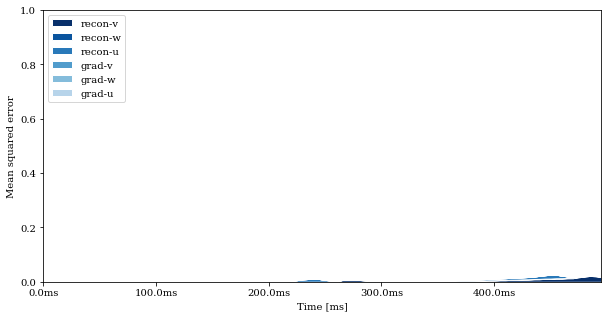

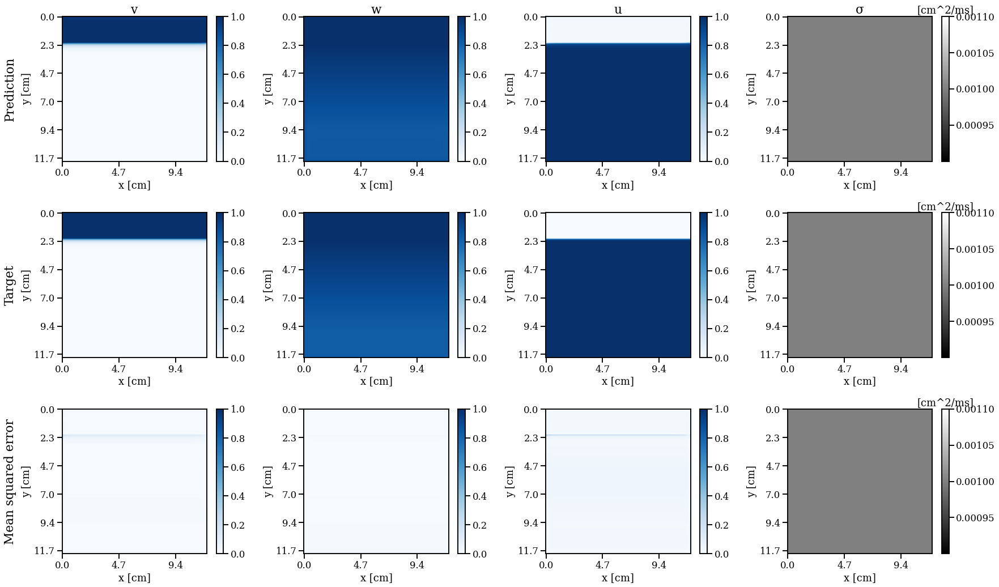

In [13]:
l1_linear = jnp.mean((ys_hat_linear - ys_linear) ** 2, axis=(0, 1, 4, 5))
j_linear = jnp.mean(grad_loss(ys_hat_linear, ys_linear), axis=(0, 1, 4, 5))
plot_loss(l1_linear, j_linear)
plt.show()

d = jnp.ones((256, 256)) * 0.001
# animate_state(ys_hat_linear, d)
# animate_state(ys_linear, d)
with sns.plotting_context("talk"):
    fig, ax = compare(ys_hat_linear[:, :, 30], ys_linear[:, :, 30], d)
    os.makedirs("results/homogeneous_conductivity", exist_ok=True)
    fig.savefig("results/homogeneous_conductivity/linear.svg")
    fig.savefig("results/homogeneous_conductivity/linear.png")
    plt.show()

## Spiral wave propagation

In [9]:
FILENAME = "data/spiral_homogeneous.hdf5"
N_REFEED = 100
URL = "p3aetobr/10351"  # TOP

In [10]:
xs_spiral, ys_spiral = take(FILENAME, 70, N_REFEED, True)
ys_hat_spiral, loss_spiral = evaluate(URL, xs_spiral, N_REFEED, ys_spiral)

(1, 1, 2, 4, 256, 256) (1, 1, 100, 3, 256, 256)
Solved forward propagation to 10000.0ms in: 6.4290642738342285s


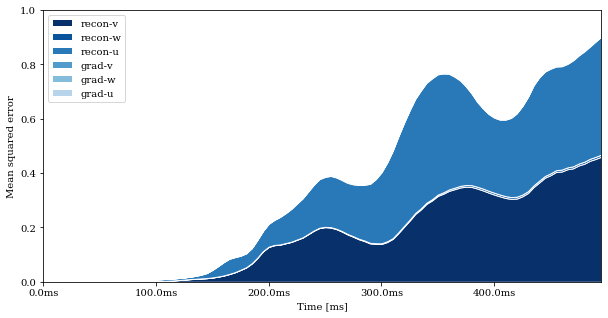

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

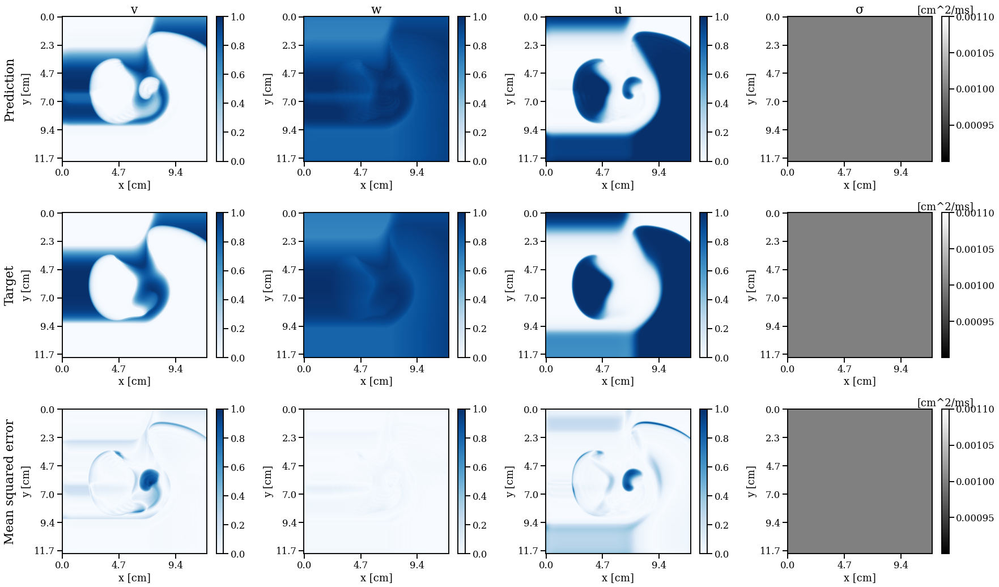

In [12]:
l1_spiral = jnp.mean((ys_hat_spiral - ys_spiral) ** 2, axis=(0, 1, 4, 5))
j_spiral = jnp.mean(grad_loss(ys_hat_spiral, ys_spiral), axis=(0, 1, 4, 5))

d = jnp.ones((256, 256)) * 0.001
# animate_state(ys_hat_spiral, d)
# animate_state(ys_spiral, d)
with sns.plotting_context("talk"):
    fig, ax = compare(ys_hat_spiral[:, :, 30], ys_spiral[:, :, 30], d)
    os.makedirs("results/homogeneous_conductivity", exist_ok=True)
    fig.savefig("results/homogeneous_conductivity/spiral.svg")
    fig.savefig("results/homogeneous_conductivity/spiral.png")
    plt.show()

## Figure

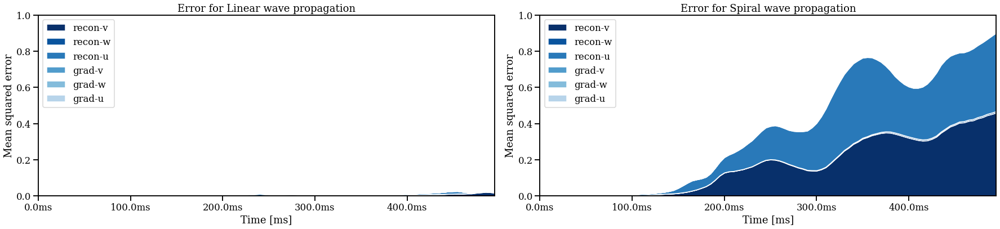

In [14]:

with sns.plotting_context("talk"):
    fig, axes = plt.subplots(1, 2, figsize=(25, 6))
    l1 = (l1_linear, l1_spiral)
    j = (j_linear, j_spiral)
    titles = ["Error for {} wave propagation".format(s) for s in ["Linear", "Spiral"]]

    # plot_accuracy(losses, ax=axes[0, 0])
    plot_loss(l1_linear, j_linear, ax=axes[0], vmax=1)
    axes[0].set_title(titles[0])
    plot_loss(l1_spiral, j_spiral, ax=axes[1], vmax=1)
    axes[1].set_title(titles[1])
    plt.tight_layout()
    fig.savefig("results/homogeneous_conductivity/loss.svg")
    fig.savefig("results/homogeneous_conductivity/loss.png")
    plt.show()